In [ ]:
!gdown https://drive.google.com/uc?id=1kCQxmbJzZPyoyt10H4QAqAUZFhqNZuZG
!unzip YouTubeFaces-subset.zip
!mv subset/* ./
!ls -l

Downloading...
From: https://drive.google.com/uc?id=1kCQxmbJzZPyoyt10H4QAqAUZFhqNZuZG
To: /content/YouTubeFaces-subset.zip
100% 496M/496M [00:02<00:00, 192MB/s]
Archive:  YouTubeFaces-subset.zip
   creating: subset/
 extracting: subset/Fred_Eckhard_1.npz  
 extracting: subset/Kevin_Spacey_3.npz  
 extracting: subset/Amanda_Beard_2.npz  
 extracting: subset/Barbara_Brezigar_2.npz  
 extracting: subset/Daniel_Kurtzer_2.npz  
 extracting: subset/Kevin_Spacey_2.npz  
 extracting: subset/Fred_Eckhard_2.npz  
 extracting: subset/Lauren_Hutton_3.npz  
 extracting: subset/Amanda_Beard_0.npz  
 extracting: subset/Daniel_Kurtzer_1.npz  
 extracting: subset/Alison_Lohman_5.npz  
 extracting: subset/Andrew_Bernard_2.npz  
 extracting: subset/Robert_F_Kennedy_Jr_0.npz  
 extracting: subset/Daniel_Kurtzer_3.npz  
 extracting: subset/Daniel_Kurtzer_0.npz  
 extracting: subset/Robert_F_Kennedy_Jr_4.npz  
 extracting: subset/Elizabeth_Berkeley_2.npz  
 extracting: subset/Amanda_Beard_4.npz  
 extractin

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

In [ ]:
df = pd.read_csv('youtube_faces_with_keypoints_full.csv')
df

,videoID,personName,imageHeight,imageWidth,videoDuration,averageFaceSize,numVideosForPerson
0,Alison_Lohman_0,Alison_Lohman,228.0,213.0,240.0,90.150000,6.0
1,Alison_Lohman_1,Alison_Lohman,248.0,201.0,79.0,108.417722,6.0
2,Alison_Lohman_2,Alison_Lohman,335.0,308.0,136.0,122.161765,6.0
3,Alison_Lohman_3,Alison_Lohman,151.0,110.0,53.0,58.000000,6.0
4,Alison_Lohman_4,Alison_Lohman,236.0,228.0,147.0,91.680272,6.0
5,Alison_Lohman_5,Alison_Lohman,227.0,179.0,68.0,105.647059,6.0
6,Kevin_Spacey_0,Kevin_Spacey,196.0,264.0,91.0,99.912088,6.0
7,Kevin_Spacey_1,Kevin_Spacey,260.0,217.0,59.0,120.186441,6.0
8,Kevin_Spacey_2,Kevin_Spacey,186.0,175.0,71.0,86.746479,6.0
9,Kevin_Spacey_3,Kevin_Spacey,100.0,89.0,99.0,44.636364,6.0


In [ ]:
import torch
import torchvision

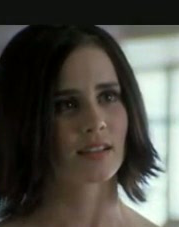

In [ ]:
def load_img(df, folder='.', crop=False, person=5, id=42):
  fn = df['videoID'][person]
  d = np.load(f'{folder}/{fn}.npz')
  imgs = d['colorImages']
  imgs = np.moveaxis(imgs, -1, 0)
  imgs_l = list(imgs)
  if crop:
    crops = d['boundingBox']
    crops = np.moveaxis(crops, -1, 0)
    crops_l = list(crops)
    box = crops_l[id]
    img = PIL.Image.fromarray(imgs_l[id])
    img = img.crop((box[0][0], box[0][1], box[3][0], box[3][1]))
    return np.asarray(img)
  return imgs_l[id]

import PIL
PIL.Image.fromarray(load_img(df))

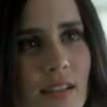

In [ ]:
PIL.Image.fromarray(load_img(df, crop=True))

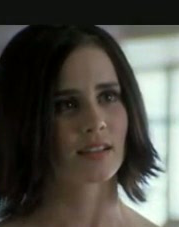

In [ ]:
img = load_img(df)
img0 = PIL.Image.fromarray(img)
img0

# Color

In [ ]:
torchvision_pretrained_transform = torchvision.models.ResNet18_Weights.DEFAULT.transforms()
img1 = torchvision_pretrained_transform(img0)
img1.shape

torch.Size([3, 224, 224])

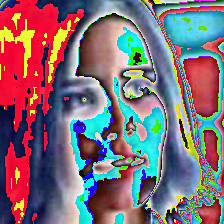

In [ ]:
to_pil_transform = torchvision.transforms.ToPILImage()
to_pil_transform(img1)

In [ ]:
manual_transform = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.ToTensor(),
  torchvision.transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
img2 = manual_transform(img0)
img2.shape

torch.Size([3, 224, 224])

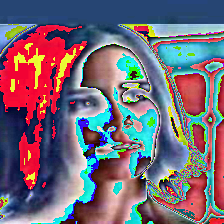

In [ ]:
to_pil_transform(img2)

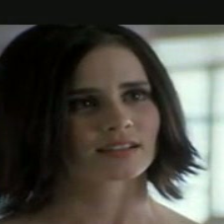

In [ ]:
transform3 = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.ToTensor(),
])
to_pil_transform(transform3(img0))

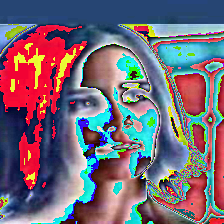

In [ ]:
transform4 = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.ToTensor(),
  torchvision.transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])
to_pil_transform(transform4(img0))

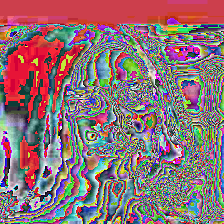

In [ ]:
transform4 = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.ToTensor(),
  torchvision.transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
  torchvision.transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])
to_pil_transform(transform4(img0))

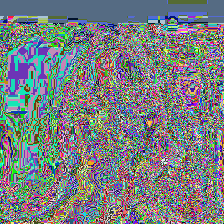

In [ ]:
transform4 = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.ToTensor(),
  torchvision.transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
  torchvision.transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
  torchvision.transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])
to_pil_transform(transform4(img0))

# The best one

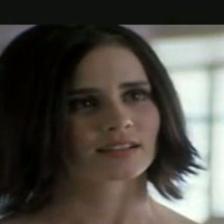

In [ ]:
transform5 = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.ToTensor(),
  torchvision.transforms.functional.autocontrast,
])
to_pil_transform(transform5(img0))

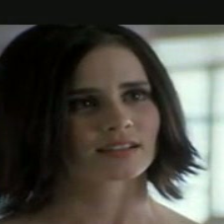

In [ ]:
to_pil_transform(transform3(img0))

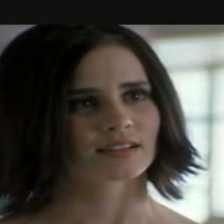

In [ ]:
transform5 = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.ToTensor(),
  torchvision.transforms.functional.autocontrast,
  torchvision.transforms.functional.autocontrast,
  torchvision.transforms.functional.autocontrast,
])
to_pil_transform(transform5(img0))

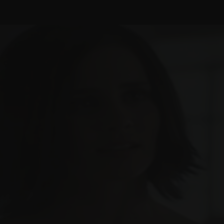

In [ ]:
def transform6_custom(img):
  img = torchvision.transforms.functional.adjust_brightness(img, 0.2)
  img = torchvision.transforms.functional.adjust_contrast(img, 0.2)
  return img

transform6 = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.ToTensor(),
  transform6_custom,
])
to_pil_transform(transform6(img0))

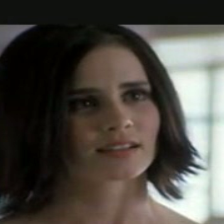

In [ ]:
transform7 = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.ToTensor(),
  transform6_custom,
  torchvision.transforms.functional.autocontrast,
])
to_pil_transform(transform7(img0))

# Color augmentation

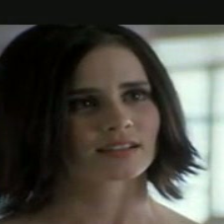

In [ ]:
# original
to_pil_transform(transform3(img0))

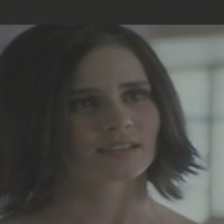

In [ ]:
def transform8_custom(img):
  img = torchvision.transforms.functional.adjust_contrast(img, 0.5)
  return img

transform8 = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.ToTensor(),
  transform8_custom,
])
to_pil_transform(transform8(img0))

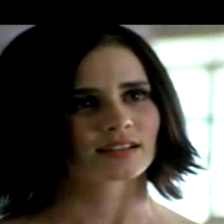

In [ ]:
def transform8_custom(img):
  img = torchvision.transforms.functional.adjust_contrast(img, 1.5)
  return img

transform8 = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.ToTensor(),
  transform8_custom,
])
to_pil_transform(transform8(img0))

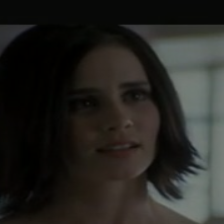

In [ ]:
def transform8_custom(img):
  img = torchvision.transforms.functional.adjust_brightness(img, 0.5)
  return img

transform8 = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.ToTensor(),
  transform8_custom,
])
to_pil_transform(transform8(img0))

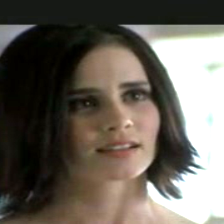

In [ ]:
def transform8_custom(img):
  img = torchvision.transforms.functional.adjust_brightness(img, 1.5)
  return img

transform8 = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.ToTensor(),
  transform8_custom,
])
to_pil_transform(transform8(img0))

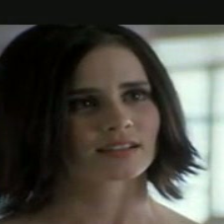

In [ ]:
# original
to_pil_transform(transform3(img0))

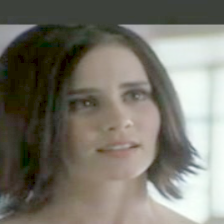

In [ ]:
def transform8_custom(img):
  img = torchvision.transforms.functional.adjust_gamma(img, 0.5)
  return img

transform8 = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.ToTensor(),
  transform8_custom,
])
to_pil_transform(transform8(img0))

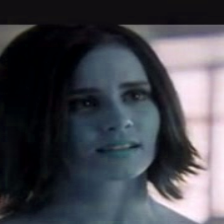

In [ ]:
def transform8_custom(img):
  img = torchvision.transforms.functional.adjust_hue(img, 0.5)
  return img

transform8 = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.ToTensor(),
  transform8_custom,
])
to_pil_transform(transform8(img0))

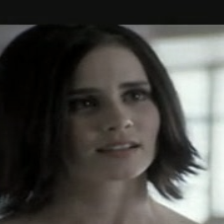

In [ ]:
def transform8_custom(img):
  img = torchvision.transforms.functional.adjust_saturation(img, 0.5)
  return img

transform8 = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.ToTensor(),
  transform8_custom,
])
to_pil_transform(transform8(img0))

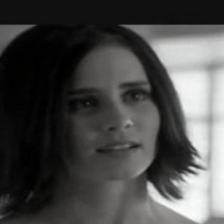

In [ ]:
def transform8_custom(img):
  img = torchvision.transforms.functional.adjust_saturation(img, 0.1)
  return img

transform8 = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.ToTensor(),
  transform8_custom,
])
to_pil_transform(transform8(img0))

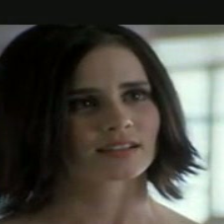

In [ ]:
# original
to_pil_transform(transform3(img0))

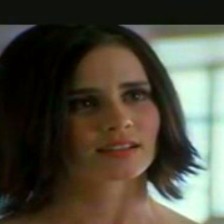

In [ ]:
def transform8_custom(img):
  img = torchvision.transforms.functional.adjust_saturation(img, 1.9)
  return img

transform8 = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.ToTensor(),
  transform8_custom,
])
to_pil_transform(transform8(img0))

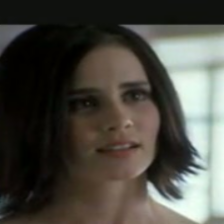

In [ ]:
def transform8_custom(img):
  img = torchvision.transforms.functional.adjust_sharpness(img, 0.5)
  return img

transform8 = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.ToTensor(),
  transform8_custom,
])
to_pil_transform(transform8(img0))

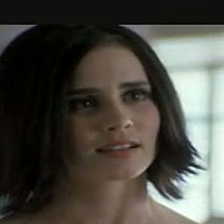

In [ ]:
def transform8_custom(img):
  img = torchvision.transforms.functional.adjust_sharpness(img, 2.5)
  return img

transform8 = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.ToTensor(),
  transform8_custom,
])
to_pil_transform(transform8(img0))

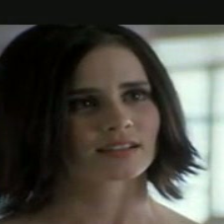

In [ ]:
# original
to_pil_transform(transform3(img0))

# Crop + Color

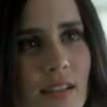

In [ ]:
img = load_img(df, crop=True)
img1 = PIL.Image.fromarray(img)
img1

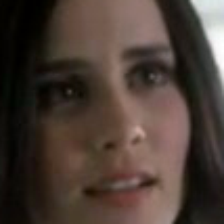

In [ ]:
to_pil_transform(transform5(img1))

# Crop

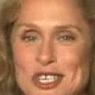

In [ ]:
img = load_img(df, crop=True, person=12)
img2 = PIL.Image.fromarray(img)
img2

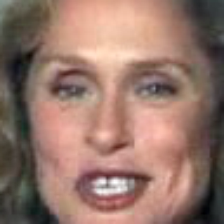

In [ ]:
to_pil_transform(transform5(img2))

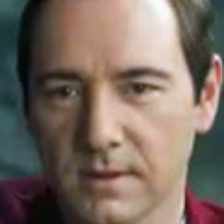

In [ ]:
img = load_img(df, crop=True, person=11)
img = PIL.Image.fromarray(img)
to_pil_transform(transform5(img))

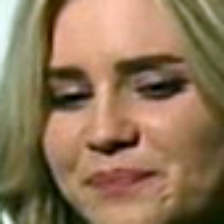

In [ ]:
img = load_img(df, crop=True, person=0)
img = PIL.Image.fromarray(img)
to_pil_transform(transform5(img))

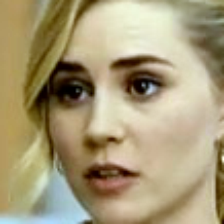

In [ ]:
img = load_img(df, crop=True, person=1)
img = PIL.Image.fromarray(img)
to_pil_transform(transform5(img))

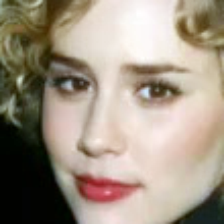

In [ ]:
img = load_img(df, crop=True, person=2)
img = PIL.Image.fromarray(img)
to_pil_transform(transform5(img))

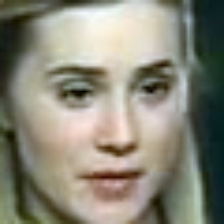

In [ ]:
img = load_img(df, crop=True, person=3)
img = PIL.Image.fromarray(img)
to_pil_transform(transform5(img))

# Face area
Mirroring the "jaw" landmarks since the face is often symmetrical vertically.

In [ ]:
import math

def mirror_point_aline(lineP1, lineP2, points):
  x1, y1 = lineP1
  x2, y2 = lineP2
  A = y2 - y1
  B = -(x2 - x1)
  C = -A * x1 - B * y1
  M = math.sqrt(A * A + B * B)
  A1 = A / M
  B1 = B / M
  C1 = C / M
  ret = []
  for px, py in points:
    D = A1 * px + B1 * py + C1
    px1 = px - 2 * A1 * D
    py1 = py - 2 * B1 * D
    ret += [[px1, py1]]
  return ret

def abs(points):
  return [[x if x > 0 else 0, y if y > 0 else 0] for x, y in points]

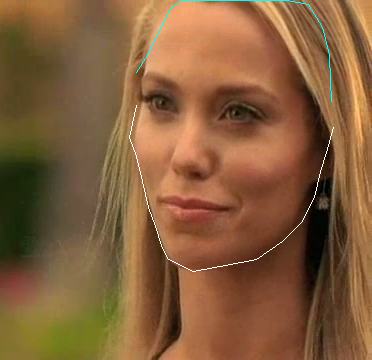

In [ ]:
import PIL
import PIL.ImageDraw

data = np.load('Elizabeth_Berkeley_1.npz')
idx = 42
img = PIL.Image.fromarray(data['colorImages'][:,:,:,idx])
cntr = data['landmarks2D'][:,:,idx]
draw = PIL.ImageDraw.Draw(img)
jawPoints          = [ 0,17]
rigthEyebrowPoints = [17,22]
leftEyebrowPoints  = [22,27]
noseRidgePoints    = [27,31]
noseBasePoints     = [31,36]
rightEyePoints     = [36,42]
leftEyePoints      = [42,48]
outerMouthPoints   = [48,60]
innerMouthPoints   = [60,68]
draw.line([(int(x[0]), int(x[1])) for x in cntr[jawPoints[0]:jawPoints[1]]], fill=0xFFFFFF)
draw.line([(int(x[0]), int(x[1])) for x in abs(mirror_point_aline(cntr[jawPoints[0]], cntr[jawPoints[1]-1], cntr[jawPoints[0]+1:jawPoints[1]-1]))], fill=0xFFFF00)
#draw.line([(int(x[0]), int(x[1])) for x in cntr[leftEyebrowPoints[0]:leftEyebrowPoints[1]]], fill=0xFF0000)
#draw.line([(int(x[0]), int(x[1])) for x in cntr[rigthEyebrowPoints[0]:rigthEyebrowPoints[1]]], fill=0xFF0000)
#draw.line([(int(x[0]), int(x[1])) for x in cntr[leftEyePoints[0]:leftEyePoints[1]]], fill=0x0000FF)
#draw.line([(int(x[0]), int(x[1])) for x in cntr[rightEyePoints[0]:rightEyePoints[1]]], fill=0x0000FF)
#draw.line([(int(x[0]), int(x[1])) for x in cntr[innerMouthPoints[0]:innerMouthPoints[1]]], fill=0x00FF00)
#draw.line([(int(x[0]), int(x[1])) for x in cntr[outerMouthPoints[0]:outerMouthPoints[1]]], fill=0x00FF00)
#draw.line([(int(x[0]), int(x[1])) for x in cntr[noseBasePoints[0]:noseBasePoints[1]]], fill=0xFFFF00)
#draw.line([(int(x[0]), int(x[1])) for x in cntr[noseRidgePoints[0]:noseRidgePoints[1]]], fill=0xFFFF00)
img

In [ ]:
def draw_point(pt, img):
  x, y = pt
  draw = PIL.ImageDraw.Draw(img)
  draw.arc([x-3, y-3, x+3, y+3], 0, 359, fill=0x0000FF)

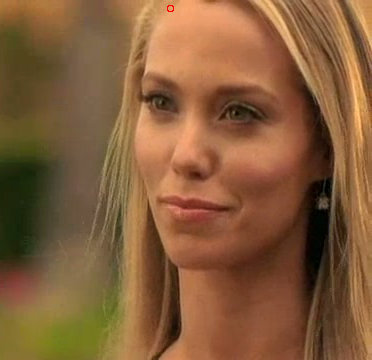

In [ ]:
pts = mirror_point_aline(cntr[jawPoints[0]], cntr[jawPoints[1]-1], cntr[jawPoints[0]+1:jawPoints[1]-1])
draw_point(pts[3], img)
img

# Some points may go negative

In [ ]:
pts

[[136.23161886341077, 72.24414017763979],
 [147.25055353370828, 55.256406993612075],
 [158.61771816863055, 32.19588730817193],
 [170.20548189244903, 8.160003053979068],
 [181.22441656274654, -8.82773013004865],
 [191.26798666429136, -26.036062402972618],
 [199.98796223245873, -37.392207263380385],
 [228.21522917568015, -44.3363703458632],
 [258.1033008423892, -31.425012088667245],
 [287.0160079403456, -18.734252920367567],
 [308.4047031277836, 4.557885628483376],
 [322.74524724505636, 27.281195123813376],
 [329.9100094164355, 54.533097498282075],
 [330.02662051764946, 81.21617081922984],
 [331.6874252411371, 101.07169215890869]]

In [ ]:
abs(pts)

[[136.23161886341077, 72.24414017763979],
 [147.25055353370828, 55.256406993612075],
 [158.61771816863055, 32.19588730817193],
 [170.20548189244903, 8.160003053979068],
 [181.22441656274654, 0],
 [191.26798666429136, 0],
 [199.98796223245873, 0],
 [228.21522917568015, 0],
 [258.1033008423892, 0],
 [287.0160079403456, 0],
 [308.4047031277836, 4.557885628483376],
 [322.74524724505636, 27.281195123813376],
 [329.9100094164355, 54.533097498282075],
 [330.02662051764946, 81.21617081922984],
 [331.6874252411371, 101.07169215890869]]

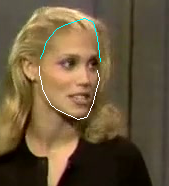

In [ ]:
def draw_face_cntr(img, cntr):
  img = PIL.Image.fromarray(img)
  draw = PIL.ImageDraw.Draw(img)
  jawPoints = [0,17]
  draw.line([(int(x[0]), int(x[1])) for x in cntr[jawPoints[0]:jawPoints[1]]], fill=0xFFFFFF)
  draw.line([(int(x[0]), int(x[1])) for x in mirror_point_aline(cntr[jawPoints[0]], cntr[jawPoints[1]-1], cntr[jawPoints[0]+1:jawPoints[1]-1])], fill=0xFFFF00)
  return img

data = np.load('Elizabeth_Berkeley_2.npz')
idx = 42
draw_face_cntr(data['colorImages'][:,:,:,idx], data['landmarks2D'][:,:,idx])

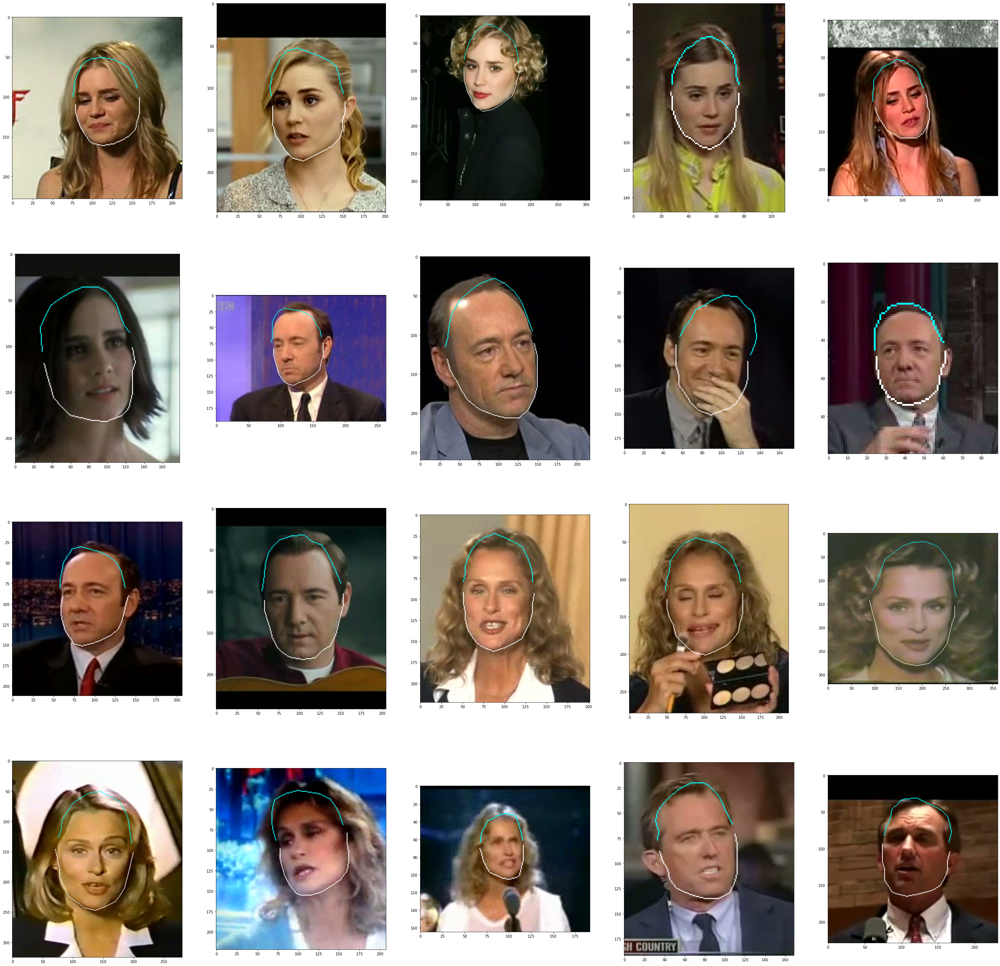

In [ ]:
n = 20
_, axs = plt.subplots(nrows=int(n/5), ncols=5, figsize=(48,48))
for i in range(n):
  fn = df['videoID'][i]
  data = np.load(f'{fn}.npz')
  idx = 42
  img = data['colorImages'][:,:,:,idx]
  cntr = data['landmarks2D'][:,:,idx]
  img = draw_face_cntr(img, cntr)
  plt.sca(axs[int(i / 5), i % 5])
  plt.imshow(img)

# Affine transform
Stretch the face to the image boundary.

In [ ]:
import cv2

src = np.float32([[0,0],[1,1],[2,2]])
dst = np.float32([[2,2],[1,1],[0,0]])
cv2.getAffineTransform(src, dst)

array([[0., 0., 0.],
       [0., 0., 0.]])

# "jaw" landmarks

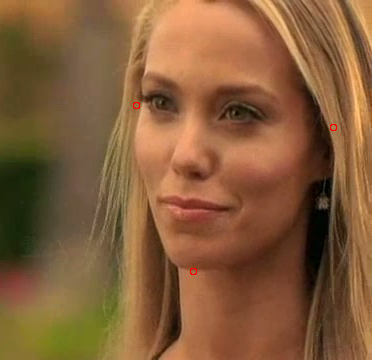

In [ ]:
img = PIL.Image.fromarray(data['colorImages'][:,:,:,idx])
cntr = data['landmarks2D'][:,:,idx]
draw_point(cntr[0], img)
draw_point(cntr[8], img)
draw_point(cntr[16], img)
img

In [ ]:
np.float32([cntr[0], cntr[8], cntr[16]])

array([[136., 105.],
       [193., 271.],
       [333., 127.]], dtype=float32)

In [ ]:
img.size

(372, 360)

In [ ]:
def get_transform_pts(img, cntr):
  src = np.float32([cntr[0], cntr[8], cntr[16]])
  dst = np.float32([[0,img.size[1]/2], [img.size[0]/2, img.size[1]], [img.size[0], img.size[1]/2]])
  return src, dst

get_transform_pts(img, cntr)

(array([[136., 105.],
        [193., 271.],
        [333., 127.]], dtype=float32), array([[  0., 180.],
        [186., 360.],
        [372., 180.]], dtype=float32))

In [ ]:
M = cv2.getAffineTransform(*get_transform_pts(img, cntr))
M

array([[ 1.83350293e+00,  4.90905622e-01, -3.00901488e+02],
       [-1.25922157e-01,  1.12757568e+00,  7.87299669e+01]])

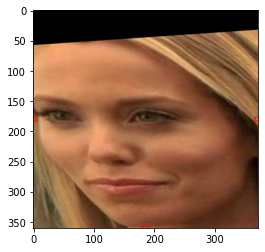

In [ ]:
img2 = cv2.warpAffine(np.array(img), M, img.size)
plt.imshow(img2)

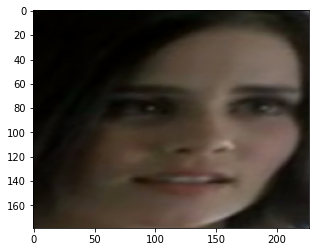

In [ ]:
def load_img3(df, folder='.', person=5, id=42):
  fn = df['videoID'][person]
  d = np.load(f'{folder}/{fn}.npz')
  img = d['colorImages'][:,:,:,id]
  cntr = d['landmarks2D'][:,:,id]
  src_pts = np.float32([cntr[0], cntr[8], cntr[16]])
  dst_pts = np.float32([[0,img.shape[1]/2], [img.shape[0]/2, img.shape[1]], [img.shape[0], img.shape[1]/2]])
  M = cv2.getAffineTransform(src_pts, dst_pts)
  img = cv2.warpAffine(img, M, img.shape[:2])
  return img

plt.imshow(load_img3(df))

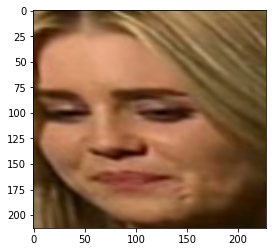

In [ ]:
plt.imshow(load_img3(df, person=0))

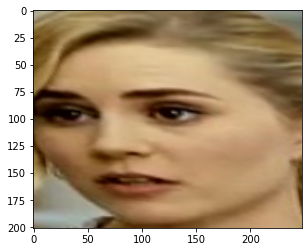

In [ ]:
plt.imshow(load_img3(df, person=1))

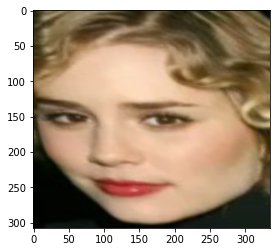

In [ ]:
plt.imshow(load_img3(df, person=2))

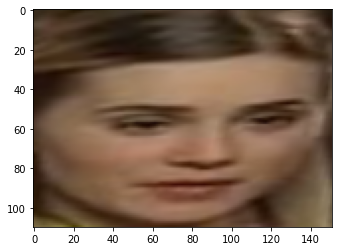

In [ ]:
plt.imshow(load_img3(df, person=3))

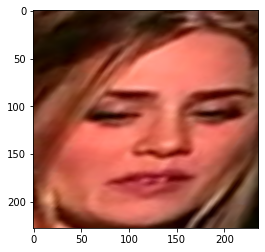

In [ ]:
plt.imshow(load_img3(df, person=4))

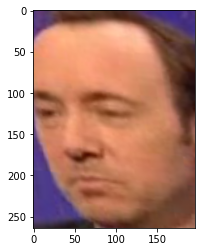

In [ ]:
plt.imshow(load_img3(df, person=6))

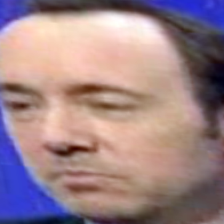

In [ ]:
img = load_img3(df, person=6)
img = PIL.Image.fromarray(img)
to_pil_transform(transform5(img))

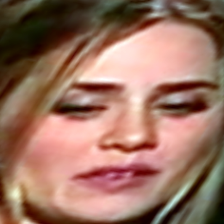

In [ ]:
img = load_img3(df, person=4)
img = PIL.Image.fromarray(img)
to_pil_transform(transform5(img))

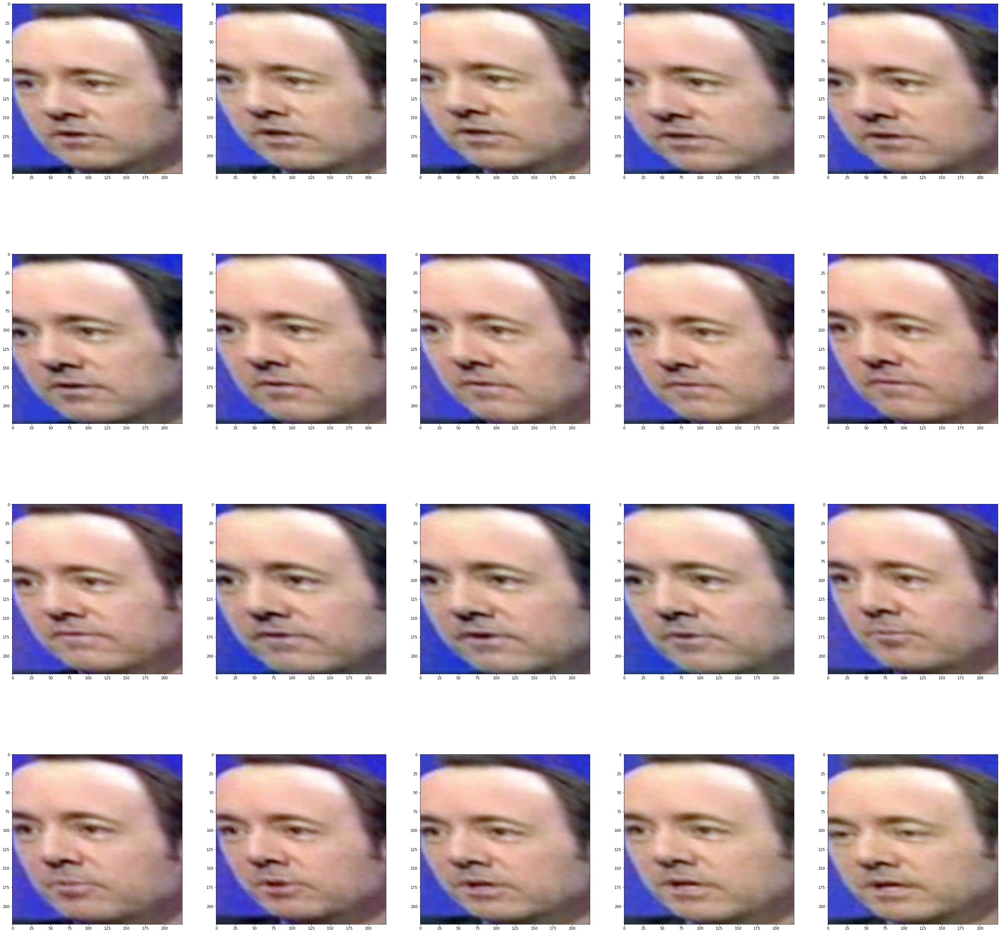

In [ ]:
n = 20
_, axs = plt.subplots(nrows=int(n/5), ncols=5, figsize=(48,48))
for i in range(n):
  img = load_img3(df, person=6, id=i)
  img = PIL.Image.fromarray(img)
  img = to_pil_transform(transform5(img))
  plt.sca(axs[int(i / 5), i % 5])
  plt.imshow(img)

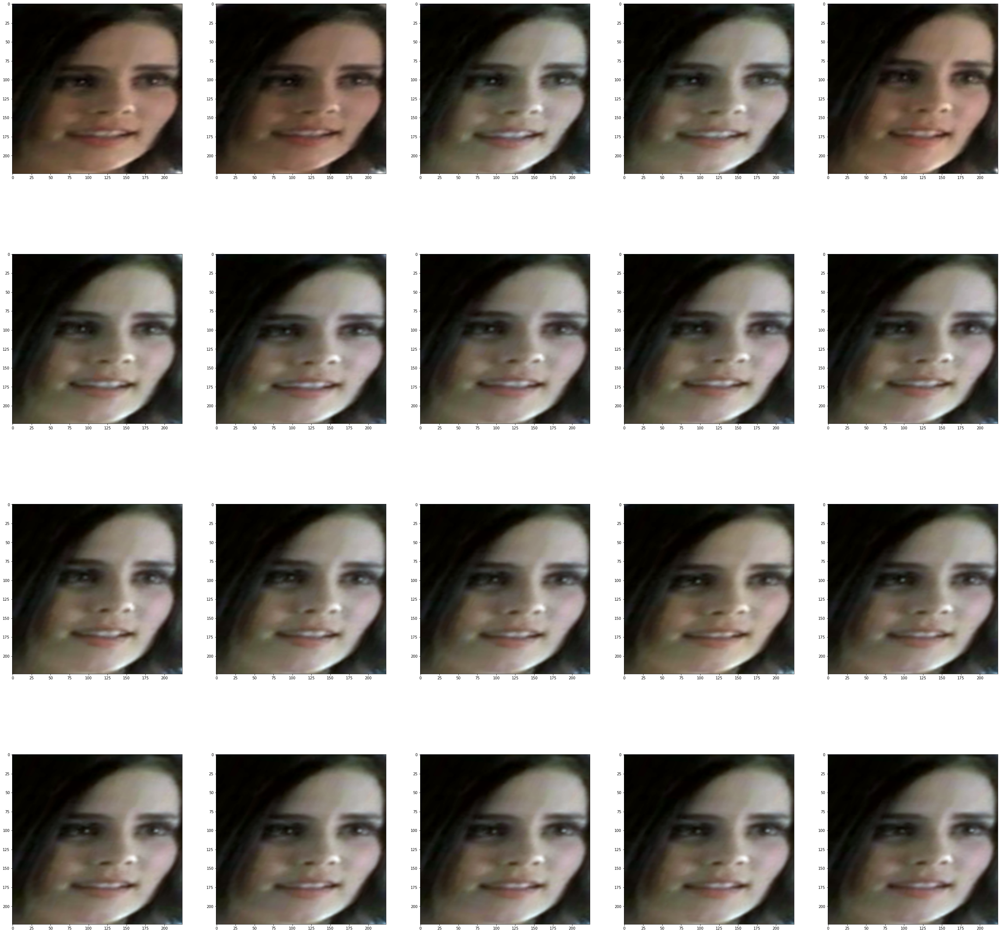

In [ ]:
n = 20
_, axs = plt.subplots(nrows=int(n/5), ncols=5, figsize=(48,48))
for i in range(n):
  img = load_img3(df, person=5, id=i)
  img = PIL.Image.fromarray(img)
  img = to_pil_transform(transform5(img))
  plt.sca(axs[int(i / 5), i % 5])
  plt.imshow(img)

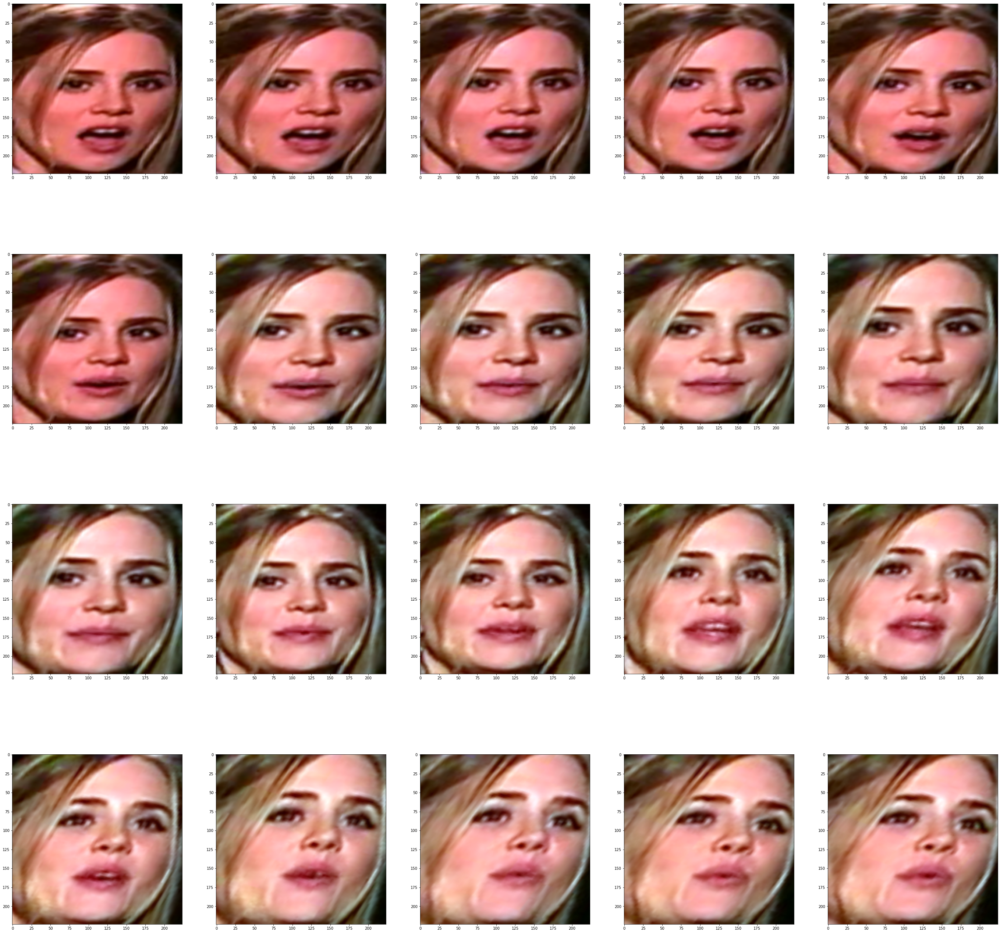

In [ ]:
n = 20
_, axs = plt.subplots(nrows=int(n/5), ncols=5, figsize=(48,48))
for i in range(n):
  img = load_img3(df, person=4, id=i)
  img = PIL.Image.fromarray(img)
  img = to_pil_transform(transform5(img))
  plt.sca(axs[int(i / 5), i % 5])
  plt.imshow(img)

# Eyes & mouth landmarks
Let's place eyes & mount at some predefined point.

In [ ]:
# Golden ratio
gr = 1.61803398875
100 / gr

61.80339887498547

In [ ]:
jawPoints          = [ 0,17]
rigthEyebrowPoints = [17,22]
leftEyebrowPoints  = [22,27]
noseRidgePoints    = [27,31]
noseBasePoints     = [31,36]
rightEyePoints     = [36,42]
leftEyePoints      = [42,48]
outerMouthPoints   = [48,60]
innerMouthPoints   = [60,68]

In [ ]:
def avg(pts):
  x = sum(x for x,y in pts) / len(pts)
  y = sum(y for x,y in pts) / len(pts)
  return x, y

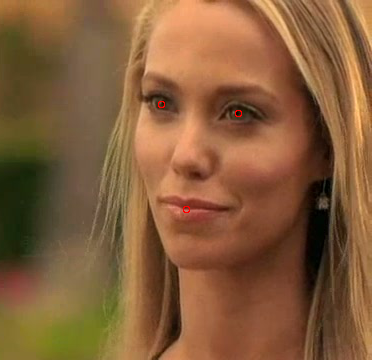

In [ ]:
import PIL
import PIL.ImageDraw

data = np.load('Elizabeth_Berkeley_1.npz')
idx = 42
img = PIL.Image.fromarray(data['colorImages'][:,:,:,idx])
cntr = data['landmarks2D'][:,:,idx]

pt1 = avg(cntr[leftEyePoints[0]:leftEyePoints[1]])
pt2 = avg(cntr[outerMouthPoints[0]:outerMouthPoints[1]])
pt3 = avg(cntr[rightEyePoints[0]:rightEyePoints[1]])

draw_point(pt1, img)
draw_point(pt2, img)
draw_point(pt3, img)

img

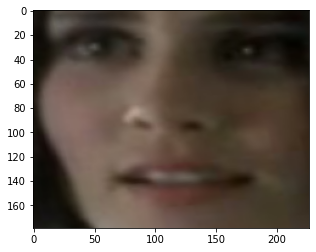

In [ ]:
import cv2

def load_img4(df, folder='.', person=5, id=42, ratio=0.2):
  fn = df['videoID'][person]
  d = np.load(f'{folder}/{fn}.npz')
  img = d['colorImages'][:,:,:,id]
  cntr = d['landmarks2D'][:,:,id]
  pt1 = avg(cntr[leftEyePoints[0]:leftEyePoints[1]])
  pt2 = avg(cntr[outerMouthPoints[0]:outerMouthPoints[1]])
  pt3 = avg(cntr[rightEyePoints[0]:rightEyePoints[1]])
  src_pts = np.float32([pt1, pt2, pt3])
  dst_pts = np.float32([
    [img.shape[0]*ratio,img.shape[1]*ratio],
    [img.shape[0]/2, img.shape[1]*(1-ratio)],
    [img.shape[0]*(1-ratio), img.shape[1]*ratio]
  ])
  M = cv2.getAffineTransform(src_pts, dst_pts)
  img = cv2.warpAffine(img, M, img.shape[:2])
  return img

plt.imshow(load_img4(df))

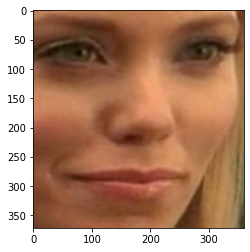

In [ ]:
plt.imshow(load_img4(df, person=44))

In [ ]:
1-1/gr

0.3819660112501453

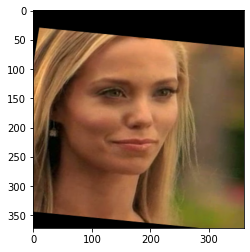

In [ ]:
plt.imshow(load_img4(df, person=44, ratio=1-1/gr))

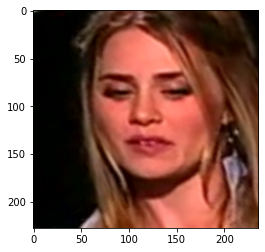

In [ ]:
plt.imshow(load_img4(df, person=4, ratio=1-1/gr))

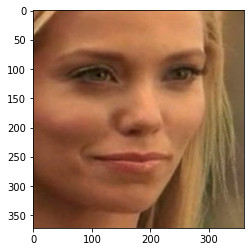

In [ ]:
plt.imshow(load_img4(df, person=44, ratio=0.3))

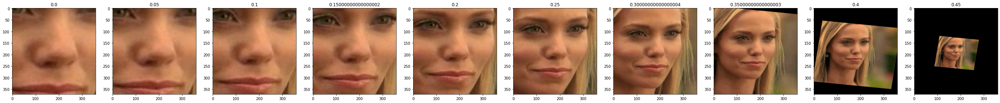

In [ ]:
n = 10
_, axs = plt.subplots(nrows=1, ncols=n, figsize=(48,48))
for i in range(n):
  plt.sca(axs[i])
  plt.title(i*0.05)
  plt.imshow(load_img4(df, person=44, ratio=i*0.05))

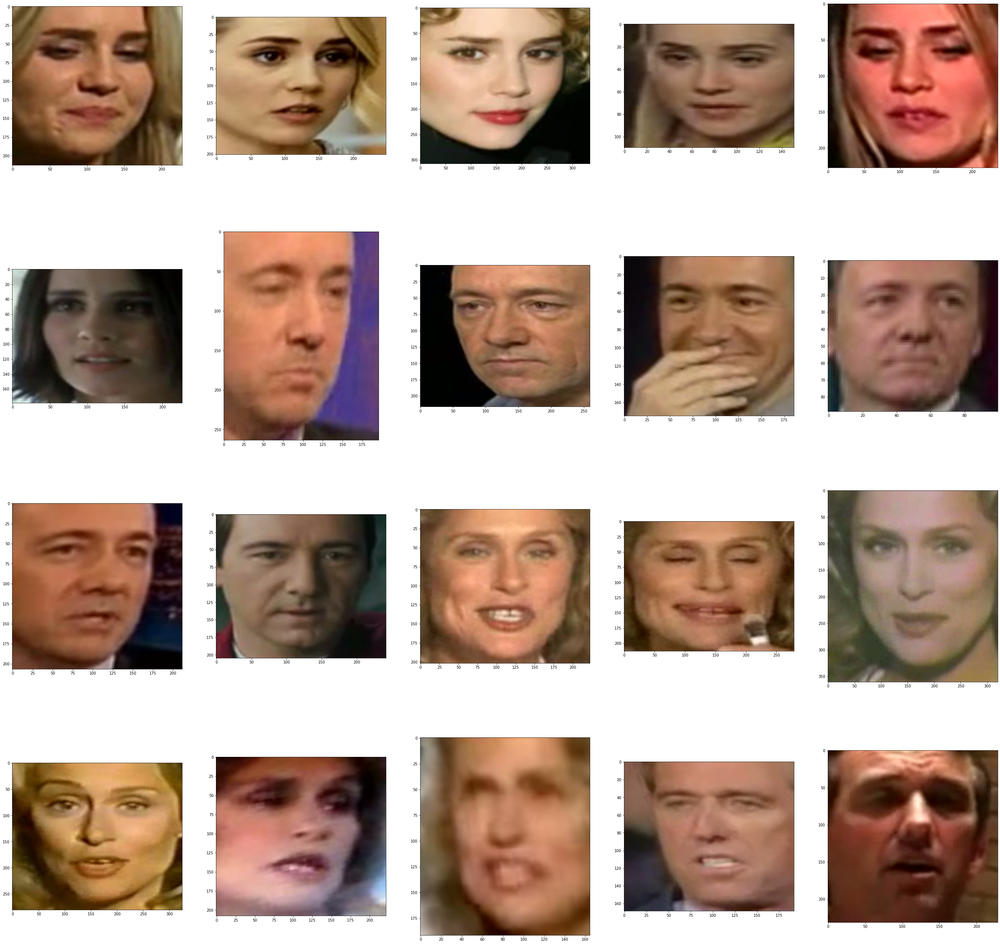

In [ ]:
n = 20
_, axs = plt.subplots(nrows=int(n/5), ncols=5, figsize=(48,48))
for i in range(n):
  plt.sca(axs[int(i / 5), i % 5])
  plt.imshow(load_img4(df, person=i, ratio=0.3))

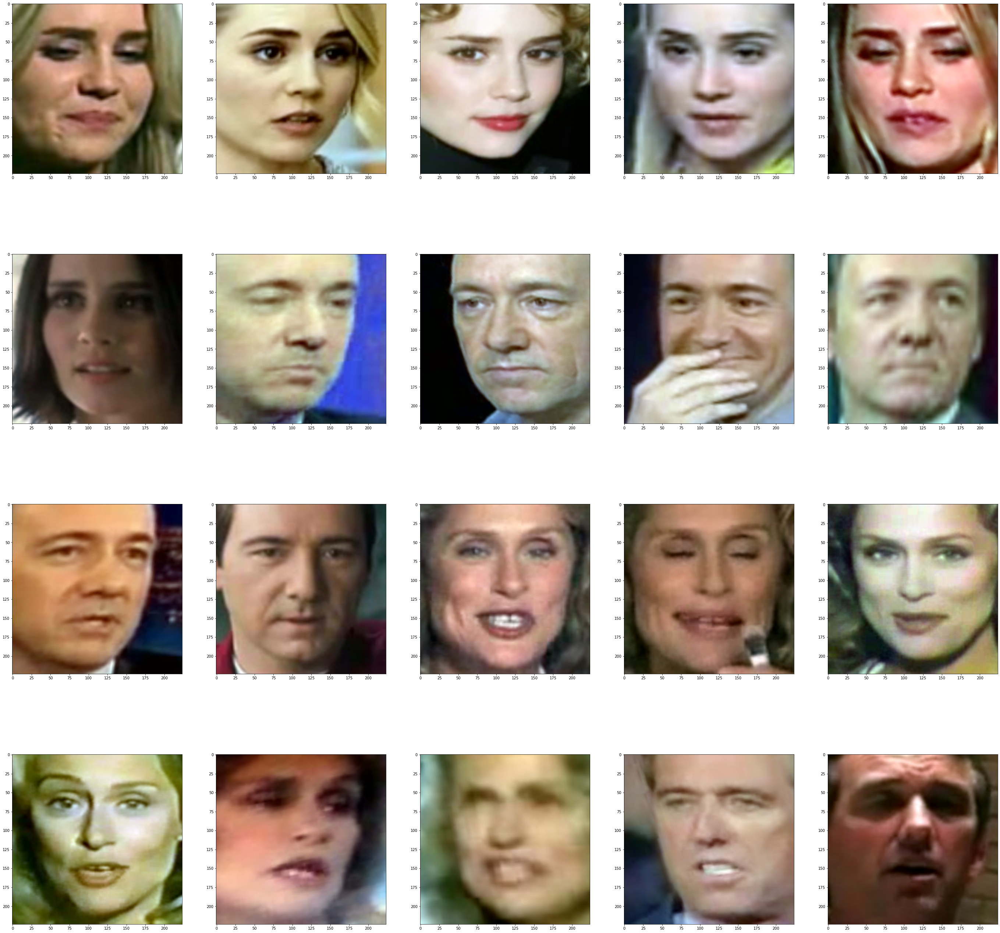

In [ ]:
n = 20
_, axs = plt.subplots(nrows=int(n/5), ncols=5, figsize=(48,48))
for i in range(n):
  plt.sca(axs[int(i / 5), i % 5])
  img = load_img4(df, person=i, ratio=0.3)
  img = PIL.Image.fromarray(img)
  img = to_pil_transform(transform5(img))
  plt.imshow(img)

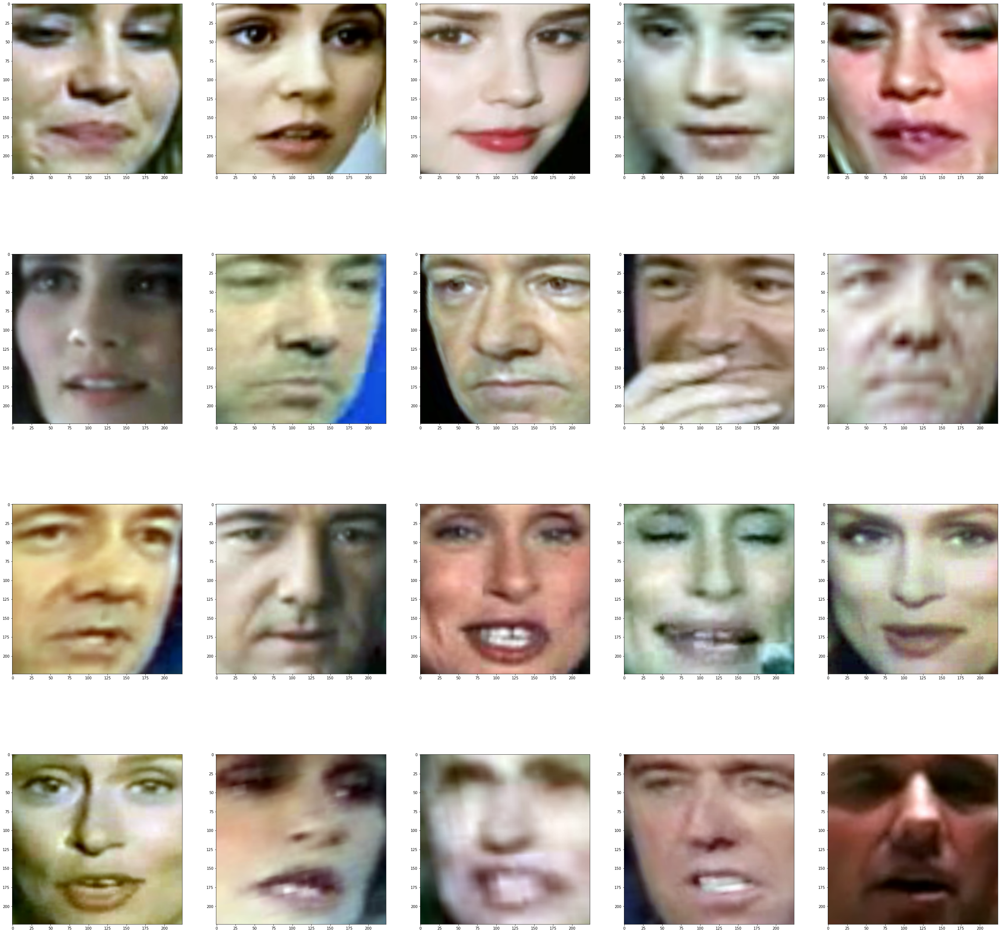

In [ ]:
n = 20
_, axs = plt.subplots(nrows=int(n/5), ncols=5, figsize=(48,48))
for i in range(n):
  plt.sca(axs[int(i / 5), i % 5])
  img = load_img4(df, person=i, ratio=0.2)
  img = PIL.Image.fromarray(img)
  img = to_pil_transform(transform5(img))
  plt.imshow(img)

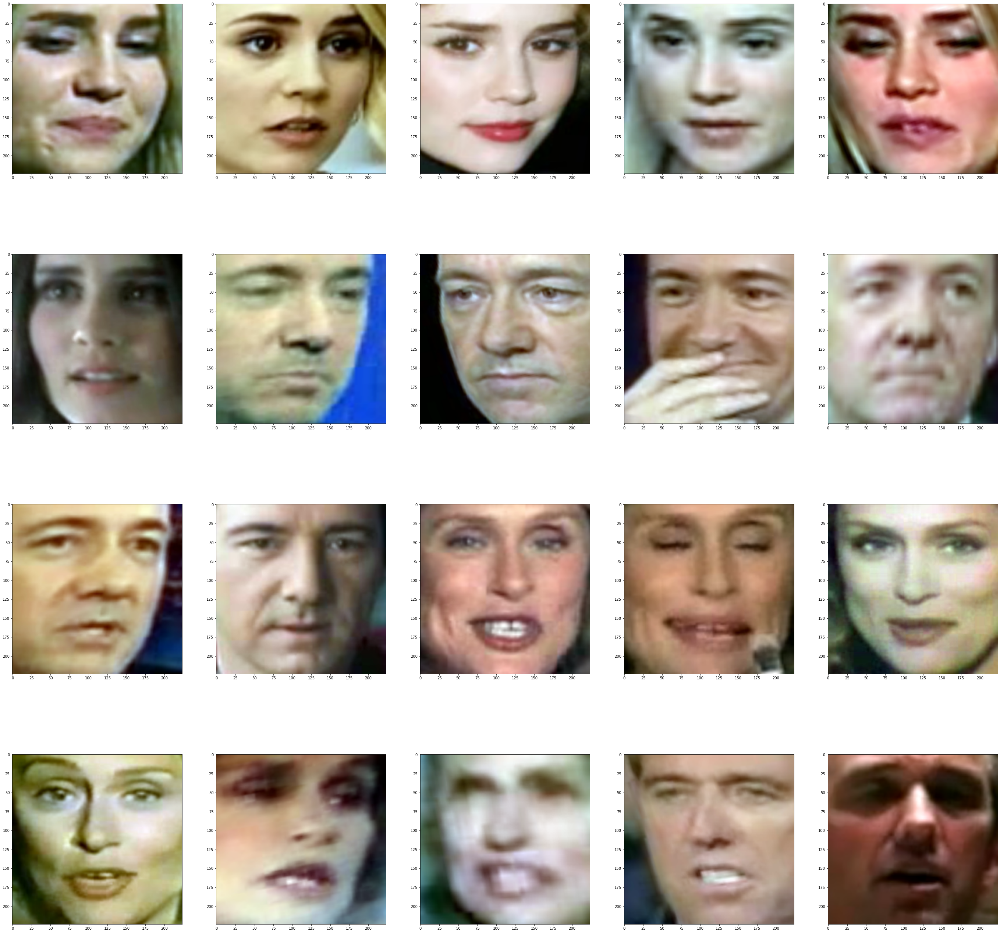

In [ ]:
n = 20
_, axs = plt.subplots(nrows=int(n/5), ncols=5, figsize=(48,48))
for i in range(n):
  plt.sca(axs[int(i / 5), i % 5])
  img = load_img4(df, person=i, ratio=0.25)
  img = PIL.Image.fromarray(img)
  img = to_pil_transform(transform5(img))
  plt.imshow(img)

# Resulting transform

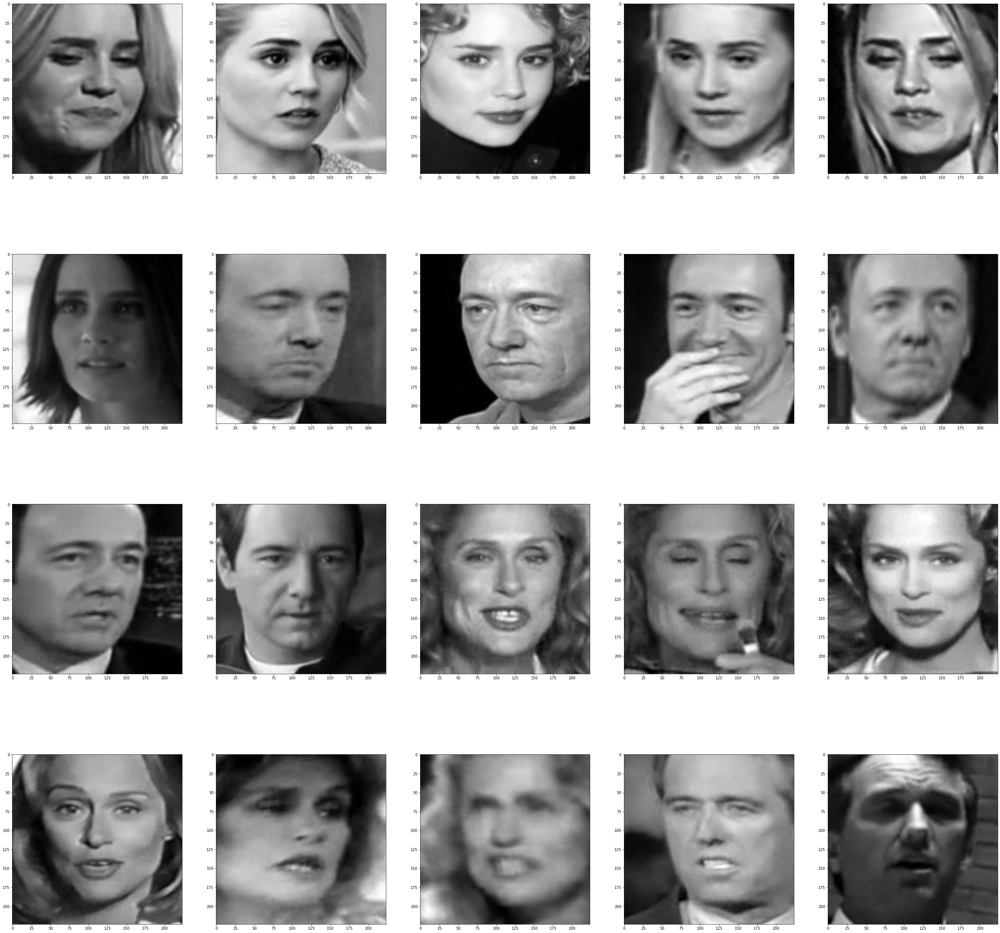

In [ ]:
transform = torchvision.transforms.Compose([
  torchvision.transforms.Resize((224, 224)),
  torchvision.transforms.functional.autocontrast,
  torchvision.transforms.functional.to_grayscale,
  torchvision.transforms.ToTensor(),
])

n = 20

_, axs = plt.subplots(nrows=int(n/5), ncols=5, figsize=(48,48))
for i in range(n):
  plt.sca(axs[int(i / 5), i % 5])
  img = load_img4(df, person=i, ratio=0.333)
  img = PIL.Image.fromarray(img)
  img = transform(img)
  plt.imshow(img.numpy().reshape(224, 224), cmap='gray')

# joblib Parallel

100%|██████████| 50/50 [00:09<00:00,  5.44it/s]
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed:    9.6s finished


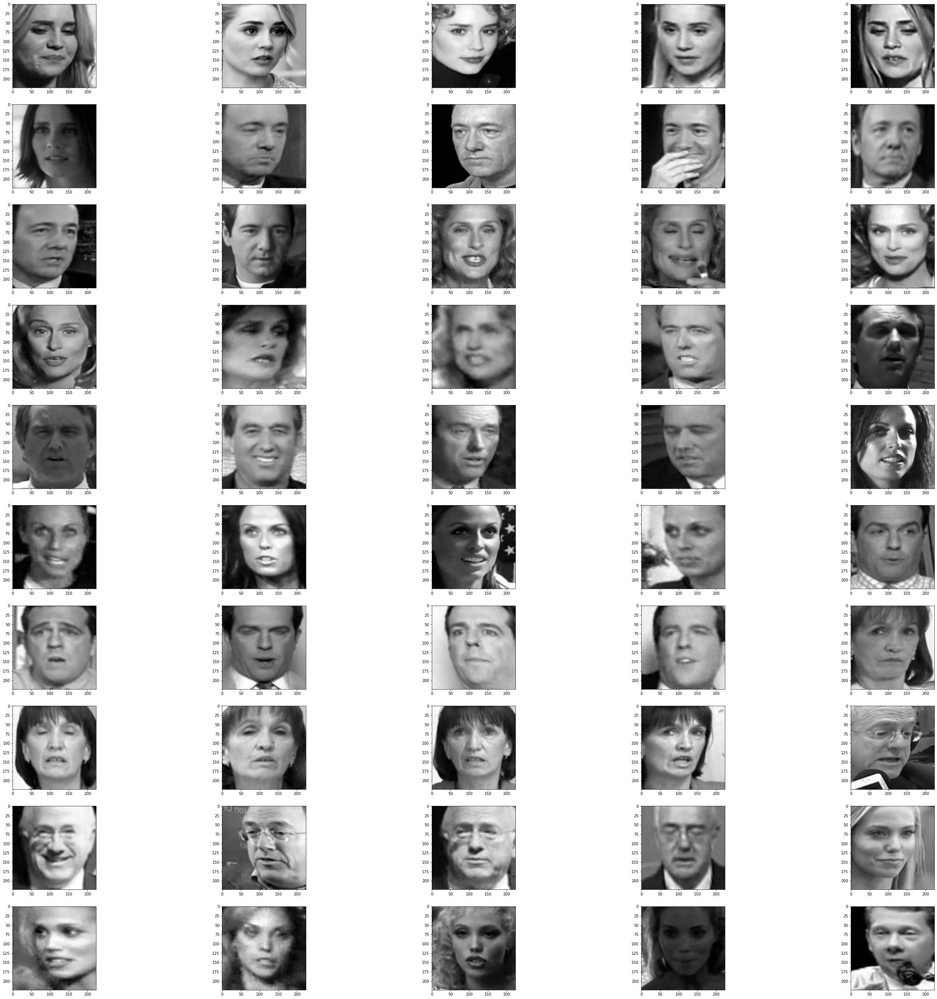

In [ ]:
from joblib import Parallel, delayed

def proc(i):
  img = load_img4(df, person=i, ratio=0.333)
  img = PIL.Image.fromarray(img)
  img = transform(img)
  img = img.numpy().reshape(224, 224)
  return img

n = 50

imgs = Parallel(n_jobs=-1, verbose=3)(delayed(proc)(i) for i in tqdm(range(n)))

_, axs = plt.subplots(nrows=int(n/5), ncols=5, figsize=(48,48))
for i in range(n):
  plt.sca(axs[int(i / 5), i % 5])
  plt.imshow(imgs[i], cmap='gray')